* https://github.com/Nixtla/statsforecast?tab=readme-ov-file

In [1]:
from datetime import datetime

notebook_start = datetime.now()

In [2]:
import os

# this makes it so that the outputs of the predict methods have the id as a column
# instead of as the index
os.environ['NIXTLA_ID_AS_COL'] = '1'

In [3]:
# prompt: mount google drive folder /TCC and load m6dataset.csv in a pandas dataframe

import pandas as pd
#from google.colab import drive

#drive.mount('/content/drive')
#df = pd.read_csv('/content/drive/My Drive/TCC/m6dataset.csv')
df = pd.read_csv('m6dataset.csv')
df

,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
0,2022-01-04,121.593811,387.981903,79.905060,150.573639,127.740082,154.622406,304.436157,167.522003,233.640442,...,76.186295,53.895573,38.697453,102.712593,169.913071,72.614227,65.310234,132.271683,204.559525,59.785252
1,2022-01-05,122.232544,381.149261,80.644165,149.208633,124.758835,150.111420,301.430847,164.356995,230.004669,...,74.273087,53.886467,38.249134,101.733925,164.688309,72.548752,65.273247,131.329620,199.040115,60.528820
2,2022-01-06,121.656784,362.743408,80.382790,148.750443,123.562485,152.650040,305.508118,163.253998,230.718994,...,74.604980,55.088196,38.811909,102.204056,163.856659,72.352287,64.598419,129.810806,198.521454,61.952503
3,2022-01-07,121.341919,355.785980,81.842987,151.528229,122.173157,147.250549,305.632568,162.554001,227.916641,...,74.614746,55.843826,39.269753,102.175285,162.349869,72.427132,65.088356,129.147568,195.213730,62.460300
4,2022-01-08,121.341919,355.785980,81.842987,151.528229,122.173157,147.250549,305.632568,162.554001,227.916641,...,74.614746,55.843826,39.269753,102.175285,162.349869,72.427132,65.088356,129.147568,195.213730,62.460300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
958,2024-08-19,196.869995,329.440002,97.540001,188.750000,132.850006,210.536530,435.339996,178.220001,216.039993,...,87.239998,91.080002,44.009998,127.739998,225.050003,80.779999,74.930000,153.800003,185.380005,118.529999
959,2024-08-20,196.149994,330.369995,97.639999,189.789993,132.210007,205.765671,434.029999,178.880005,216.580002,...,87.180000,88.680000,43.869999,127.389999,224.259995,81.180000,74.769997,154.419998,185.210007,114.580002
960,2024-08-21,196.529999,333.600006,98.010002,189.830002,134.509995,208.720001,433.609985,180.110001,217.039993,...,87.550003,88.830002,43.799999,128.160004,225.580002,81.730003,75.300003,154.679993,187.550003,113.849998
961,2024-08-22,196.369995,330.570007,98.290001,189.750000,135.009995,200.199997,433.700012,176.130005,218.020004,...,86.889999,89.059998,44.049999,128.000000,220.389999,81.610001,75.209999,154.779999,184.309998,114.730003


In [4]:
TEST_ROWS = 7

# Splitting the dataframe into train and test sets
train_df = df.iloc[:-TEST_ROWS]
test_df = df.iloc[-TEST_ROWS:]
train_df

,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
0,2022-01-04,121.593811,387.981903,79.905060,150.573639,127.740082,154.622406,304.436157,167.522003,233.640442,...,76.186295,53.895573,38.697453,102.712593,169.913071,72.614227,65.310234,132.271683,204.559525,59.785252
1,2022-01-05,122.232544,381.149261,80.644165,149.208633,124.758835,150.111420,301.430847,164.356995,230.004669,...,74.273087,53.886467,38.249134,101.733925,164.688309,72.548752,65.273247,131.329620,199.040115,60.528820
2,2022-01-06,121.656784,362.743408,80.382790,148.750443,123.562485,152.650040,305.508118,163.253998,230.718994,...,74.604980,55.088196,38.811909,102.204056,163.856659,72.352287,64.598419,129.810806,198.521454,61.952503
3,2022-01-07,121.341919,355.785980,81.842987,151.528229,122.173157,147.250549,305.632568,162.554001,227.916641,...,74.614746,55.843826,39.269753,102.175285,162.349869,72.427132,65.088356,129.147568,195.213730,62.460300
4,2022-01-08,121.341919,355.785980,81.842987,151.528229,122.173157,147.250549,305.632568,162.554001,227.916641,...,74.614746,55.843826,39.269753,102.175285,162.349869,72.427132,65.088356,129.147568,195.213730,62.460300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
951,2024-08-12,190.179993,313.959991,97.139999,178.460007,128.759995,192.720657,404.540009,166.800003,209.360001,...,84.620003,89.849998,42.180000,123.650002,207.309998,78.750000,73.739998,149.410004,173.649994,118.049599
952,2024-08-13,191.229996,319.329987,98.129997,184.320007,130.089996,200.415924,408.260010,170.229996,211.750000,...,85.720001,88.980003,42.529999,124.949997,213.679993,79.110001,74.169998,151.220001,178.000000,116.918709
953,2024-08-14,193.000000,319.829987,97.239998,185.979996,131.089996,201.244339,419.869995,170.100006,213.520004,...,85.230003,89.500000,43.049999,125.459999,214.850006,79.470001,74.120003,151.759995,177.050003,118.000000
954,2024-08-15,193.399994,325.130005,96.559998,184.059998,132.949997,211.424820,424.070007,177.589996,214.679993,...,86.000000,90.570000,43.450001,127.150002,221.029999,80.290001,74.110001,152.710007,182.699997,118.730003


In [5]:
test_df

,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
956,2024-08-17,193.899994,326.920013,96.940002,187.270004,131.270004,207.502335,431.390015,177.059998,215.210007,...,86.260002,90.470001,43.770000,126.970001,221.399994,80.510002,74.440002,152.869995,183.130005,118.169998
957,2024-08-18,193.899994,326.920013,96.940002,187.270004,131.270004,207.502335,431.390015,177.059998,215.210007,...,86.260002,90.470001,43.770000,126.970001,221.399994,80.510002,74.440002,152.869995,183.130005,118.169998
958,2024-08-19,196.869995,329.440002,97.540001,188.750000,132.850006,210.536530,435.339996,178.220001,216.039993,...,87.239998,91.080002,44.009998,127.739998,225.050003,80.779999,74.930000,153.800003,185.380005,118.529999
959,2024-08-20,196.149994,330.369995,97.639999,189.789993,132.210007,205.765671,434.029999,178.880005,216.580002,...,87.180000,88.680000,43.869999,127.389999,224.259995,81.180000,74.769997,154.419998,185.210007,114.580002
960,2024-08-21,196.529999,333.600006,98.010002,189.830002,134.509995,208.720001,433.609985,180.110001,217.039993,...,87.550003,88.830002,43.799999,128.160004,225.580002,81.730003,75.300003,154.679993,187.550003,113.849998
961,2024-08-22,196.369995,330.570007,98.290001,189.750000,135.009995,200.199997,433.700012,176.130005,218.020004,...,86.889999,89.059998,44.049999,128.000000,220.389999,81.610001,75.209999,154.779999,184.309998,114.730003
962,2024-08-23,197.550003,333.269989,98.250000,193.009995,137.000000,202.669998,439.679993,177.039993,221.729996,...,87.500000,90.389999,44.430000,129.279999,223.960007,81.839996,75.419998,155.449997,187.869995,116.320000


In [6]:
df.columns[2:]

Index(['ACN', 'AEP', 'AIZ', 'ALLE', 'AMAT', 'AMP', 'AMZN', 'AVB', 'AVY', 'AXP',
       'BDX', 'BF-B', 'BMY', 'BR', 'CARR', 'CDW', 'CE', 'CHTR', 'CNC', 'CNP',
       'COP', 'CTAS', 'CZR', 'DG', 'DPZ', 'DXC', 'EWA', 'EWC', 'EWG', 'EWH',
       'EWJ', 'EWL', 'EWQ', 'EWT', 'EWU', 'EWY', 'EWZ', 'FTV', 'GOOG', 'GPC',
       'GSG', 'HIG', 'HIGH.L', 'HST', 'HYG', 'IAU', 'ICLN', 'IEAA.L', 'IEF',
       'IEFM.L', 'IEMG', 'IEUS', 'IEVL.L', 'IGF', 'INDA', 'IUMO.L', 'IUVL.L',
       'IVV', 'IWM', 'IXN', 'JPEA.L', 'JPM', 'KR', 'LQD', 'MCHI', 'META',
       'MVEU.L', 'OGN', 'PG', 'PPL', 'PRU', 'PYPL', 'REET', 'ROL', 'ROST',
       'SEGA.L', 'SHY', 'SLV', 'SPMV.L', 'TLT', 'UNH', 'URI', 'V', 'VRSK',
       'VXX', 'WRK', 'XLB', 'XLC', 'XLE', 'XLF', 'XLI', 'XLK', 'XLP', 'XLU',
       'XLV', 'XLY', 'XOM'],
      dtype='object')

In [7]:
# prompt: create a method for plotting df using an interactive line graph, one line for columns, starting from column 2, column 1 is the index, ignore column 0. the graph must show only the legend and value of the line where the mouse hovers over.
import plotly.express as px

def plot_df(df):
  df = df.set_index(df.columns[0])
  fig = px.line(df, x=df.index, y=df.columns[2:], hover_data={"variable":False})
  fig.update_traces(mode='lines', hovertemplate=None)
  # fig.update_layout(hovermode="x unified")
  fig.update_layout(
      title='M6 Dataset',
      xaxis_title='Days',
      yaxis_title='Adj. Values',
      hovermode='closest',  # Ensures that only the data point under the cursor is displayed
      showlegend=True       # Display legend
  )
  fig.show()

plot_df(df)

# NIXTLA

https://nixtlaverse.nixtla.io/statsforecast/docs/models/autoarima.html

In [8]:
#!pip install statsforecast

In [9]:
import warnings
warnings.filterwarnings('ignore')

In [10]:
def convert_nixtla(df):
  dfn = pd.DataFrame(columns=['unique_id', 'ds', 'y'])

  for col in df.columns[1:]:
    temp = df[['Date', col]].copy()
    temp['unique_id'] = col
    temp.rename(columns={'Date':'ds', col: 'y'}, inplace=True)
    dfn = pd.concat([dfn, temp], ignore_index=True)

  return dfn

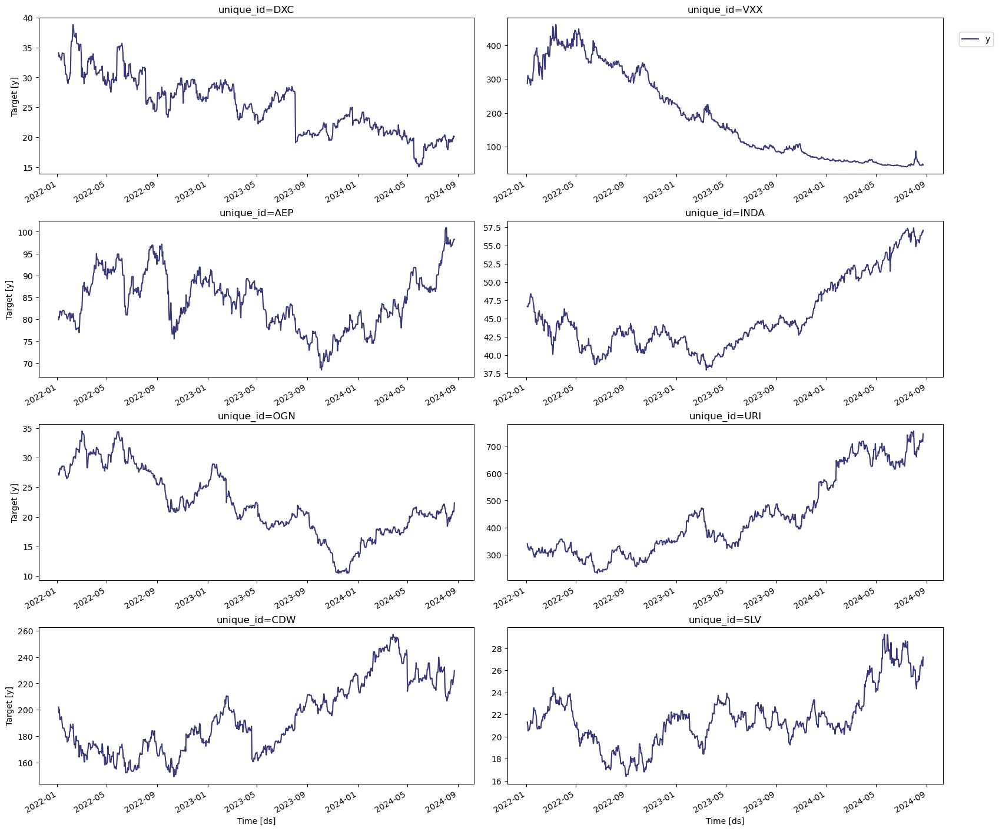

In [11]:
from statsforecast import StatsForecast

StatsForecast.plot(convert_nixtla(df))

In [12]:
# https://github.com/Nixtla/statsforecast?tab=readme-ov-file
from statsforecast.models import AutoARIMA

frequency = 'D' # 'B' business day frequency (https://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html#offset-aliases)
sazonality = 7

sf = StatsForecast(
        models = [AutoARIMA(season_length = sazonality)],
        freq = frequency,
        n_jobs=-1
    )

In [13]:
%%time
horizon = 1

start_time = datetime.now()

for i in range(0, TEST_ROWS):
  print('--- FORECASTING ' + str(i+1) + ' ---')

  pred = sf.forecast(h=horizon, df=convert_nixtla(train_df))

  # transposing the prediction and adjustin columns
  date_value = pd.to_datetime(pred['ds'].iloc[0]).strftime('%Y-%m-%d')
  pred.set_index('unique_id', inplace=True)
  predt = pred.drop(columns=['ds']).T
  predt.insert(0, 'Date', date_value)
  try:
      preds = pd.concat([preds, predt])
  except NameError:
      preds = predt

  # prompt: concat row i from test_df at the end of train_df
  train_df = pd.concat([train_df, test_df.iloc[[i]]])

stop_time = datetime.now()
elapsed_time = stop_time - start_time

print(f"Cell started at: {start_time}")
print(f"Cell stopped at: {stop_time}")
print(f"Elapsed time: {elapsed_time}")

--- FORECASTING 1 ---
--- FORECASTING 2 ---
--- FORECASTING 3 ---
--- FORECASTING 4 ---
--- FORECASTING 5 ---
--- FORECASTING 6 ---
--- FORECASTING 7 ---
Cell started at: 2024-09-04 18:49:13.450795
Cell stopped at: 2024-09-04 18:54:19.651003
Elapsed time: 0:05:06.200208
CPU times: user 1.86 s, sys: 414 ms, total: 2.27 s
Wall time: 5min 6s


In [14]:
import IPython
IPython.display.Audio("file_example_MP3_1MG.mp3", autoplay=True)

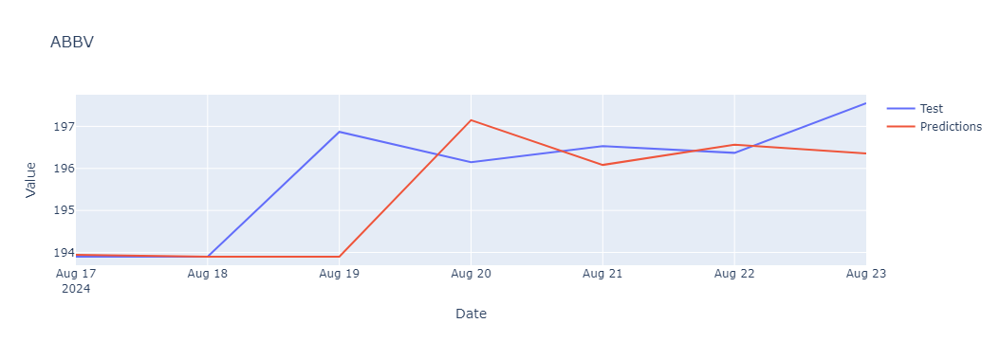

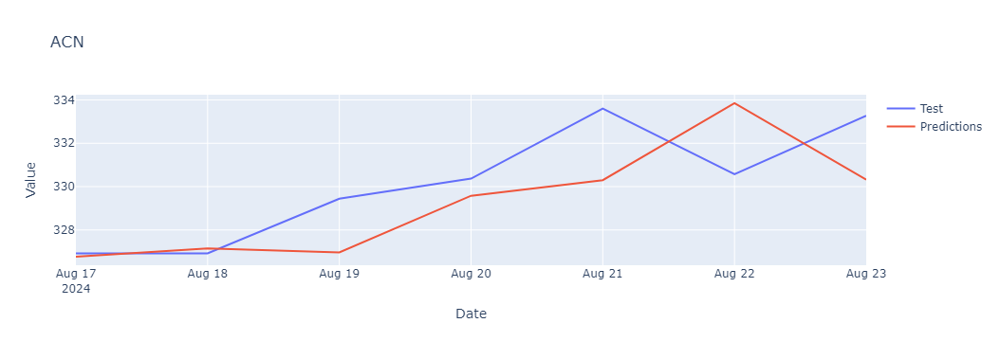

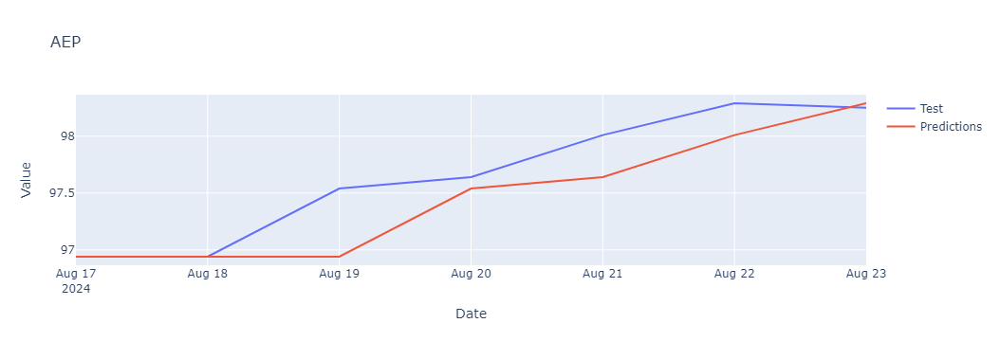

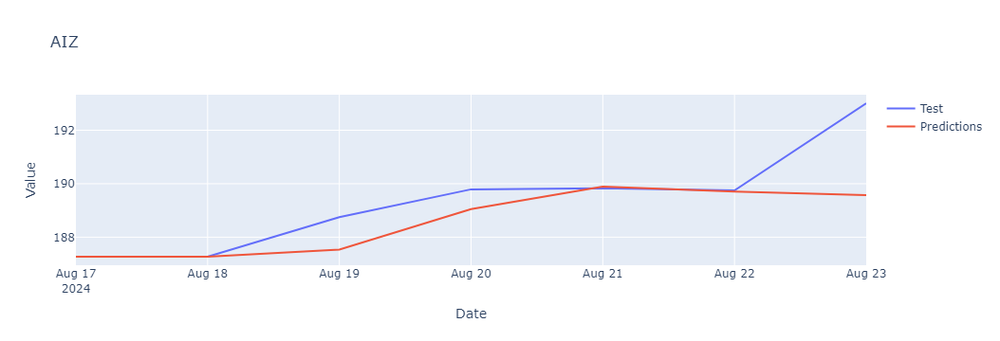

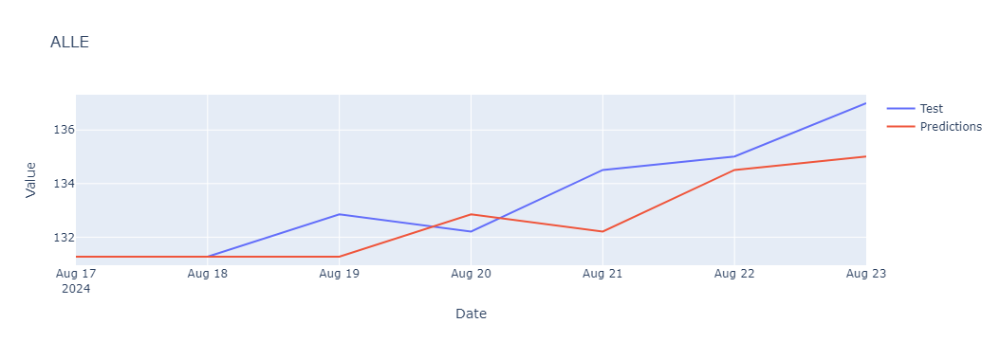

...

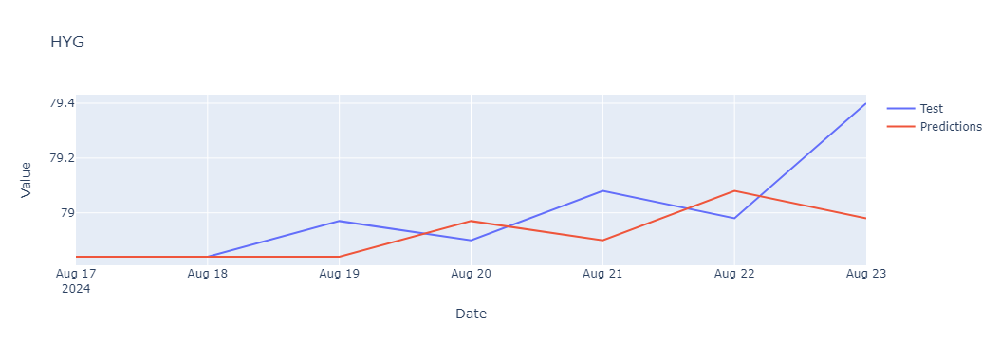

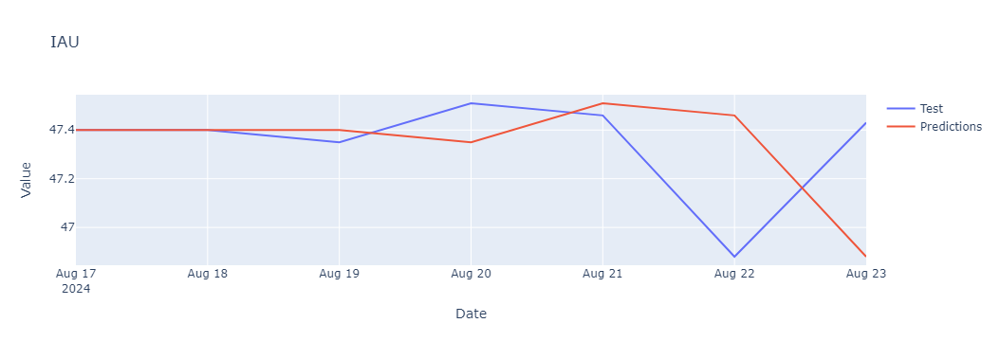

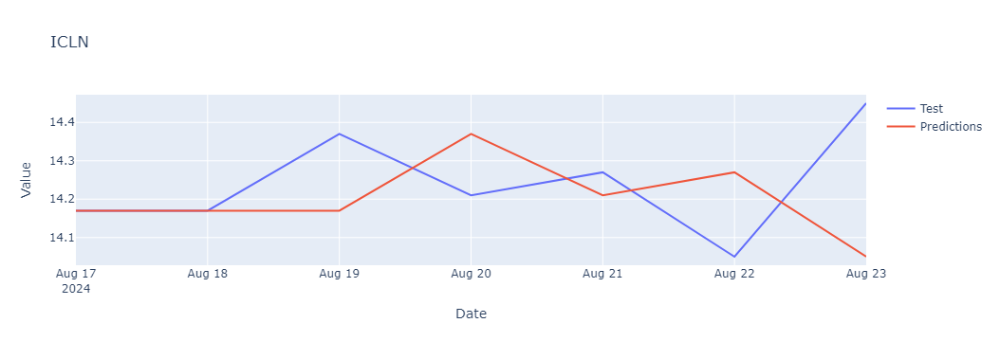

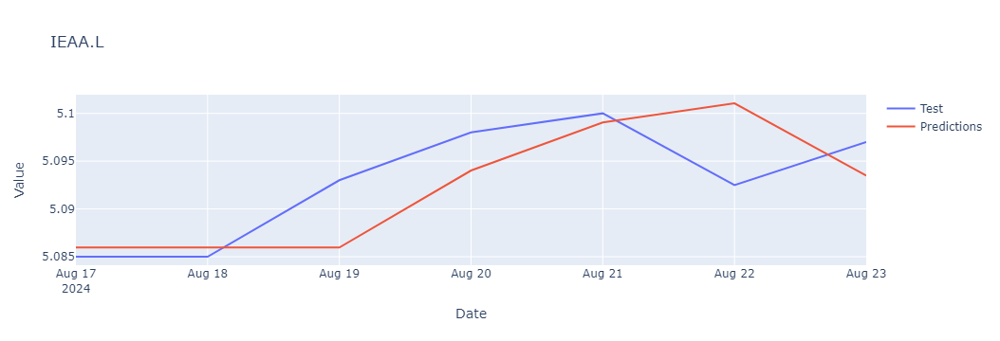

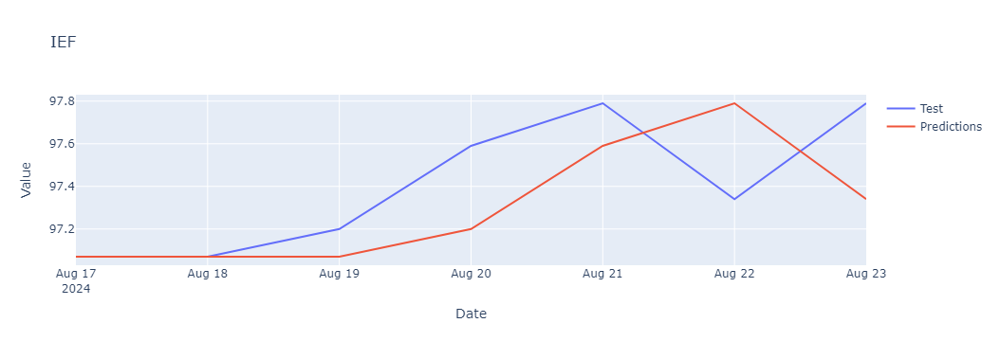

In [15]:
# prompt: plot columns 1 from test_df and preds, the title is the column name

import plotly.graph_objects as go

def plot_pred_vs_test(test_df, preds):
  for col in test_df.columns[1:]:
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=test_df['Date'], y=test_df[col], mode='lines', name='Test'))
    fig.add_trace(go.Scatter(x=preds['Date'], y=preds[col], mode='lines', name='Predictions'))
    fig.update_layout(title=col, xaxis_title='Date', yaxis_title='Value')
    fig.show()

plot_pred_vs_test(test_df, preds)


In [16]:
# prompt: compare test_df and preds columns MAE, RSME and POCID, put results in a pandas dataframe

from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

def pocid(actual, forecast):
  actual = np.array(actual)
  forecast = np.array(forecast)
  sum_abs_diff = np.sum(np.abs(actual - forecast))
  sum_actual = np.sum(actual)
  return (sum_abs_diff / sum_actual) * 100

results = []
for col in test_df.columns[1:]:
  mae = mean_absolute_error(test_df[col], preds[col])
  rmse = np.sqrt(mean_squared_error(test_df[col], preds[col]))
  pocid_val = pocid(test_df[col], preds[col])
  results.append([col, mae, rmse, pocid_val])

results_df = pd.DataFrame(results, columns=['Column', 'MAE', 'RMSE', 'POCID'])
results_df

,Column,MAE,RMSE,POCID
0,ABBV,0.836051,1.280948,0.426784
1,ACN,1.883148,2.305359,0.570382
2,AEP,0.198571,0.289556,0.203332
3,AIZ,0.784555,1.407002,0.414272
4,ALLE,1.001428,1.331276,0.750438
...,...,...,...,...
93,XLP,0.224286,0.293428,0.276331
94,XLU,0.211430,0.292479,0.282170
95,XLV,0.368572,0.503673,0.239139
96,XLY,1.651428,2.195391,0.891576


In [18]:
notebook_stop = datetime.now()

print(f"Notebook started at: {notebook_start}")
print(f"Notebook stopped at: {notebook_stop}")

exec_df = pd.DataFrame({
  'Model': ['arima-multi'],
  'Cell Start': [start_time],
  'Cell Stop': [stop_time],
  'Cell Elapsed': [elapsed_time],
  'Note Start': [notebook_start],
  'Note Stop': [notebook_stop]
})

Notebook started at: 2024-09-04 18:49:09.341053
Notebook stopped at: 2024-09-04 18:55:09.036404


In [19]:
# prompt: save results_df into the TCC drive named autoarima.csv
preds.to_csv('arima-with_update-pred.csv', index=False)
test_df.to_csv('arima-with_update-val.csv', index=False)
results_df.to_csv('arima-with_update-metrics.csv', index=False)
exec_df.to_csv('arima-with_update-exec_time.csv', index=False)